# Install Dependencies


In [1]:
!git clone https://github.com/ultralytics/yolov5 

Cloning into 'yolov5'...
remote: Enumerating objects: 15287, done.
remote: Total 15287 (delta 0), reused 0 (delta 0), pack-reused 15287
Receiving objects: 100% (15287/15287), 14.18 MiB | 16.69 MiB/s, done.
Resolving deltas: 100% (10489/10489), done.


In [2]:
%cd yolov5
!git reset --hard fbe67e465375231474a2ad80a4389efc77ecff99

/content/yolov5
HEAD is now at fbe67e4 Fix `OMP_NUM_THREADS=1` for macOS (#8624)


In [3]:
!pip install -qr requirements.txt  

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 38.0 MB/s eta 0:00:00


In [4]:
import torch
from IPython.display import Image, clear_output

# Download DataSet

In [5]:
%pwd

'/content/yolov5'

In [6]:
!wget  -q https://www.dropbox.com/s/5rott1kw20ebmhp/Smoke%20Detection.v1i.yolov5pytorch.zip?dl=0 --output-document smokeData.zip

In [7]:
data_path = "/content/yolov5/smokeData.zip"

In [8]:
!unzip -q $data_path -d wildfireData

In [9]:
dataset_location = "wildfireData"

In [10]:
!rm $data_path

# Model Configuration and Architecture

In [11]:
%cat {dataset_location}/data.yaml

train: ../train/images
val: ../valid/images
test: ../test/images

nc: 1
names: ['0']

roboflow:
  workspace: project
  project: smoke-detection-l0mxg
  version: 1
  license: CC BY 4.0
  url: https://universe.roboflow.com/project/smoke-detection-l0mxg/dataset/1

### Correct the Data.yaml

In [12]:

import yaml

In [13]:
data_dict = {}
with open(dataset_location + "/data.yaml", 'r') as stream:
    data_dict = yaml.safe_load(stream)
    #num_classes = str(yaml.safe_load(stream)['nc'])
    

In [14]:
data_dict

{'train': '../train/images',
 'val': '../valid/images',
 'test': '../test/images',
 'nc': 1,
 'names': ['0'],
 'roboflow': {'workspace': 'project',
  'project': 'smoke-detection-l0mxg',
  'version': 1,
  'license': 'CC BY 4.0',
  'url': 'https://universe.roboflow.com/project/smoke-detection-l0mxg/dataset/1'}}

In [15]:
num_classes = data_dict['nc']

In [16]:
num_classes

1

In [17]:
train_folder = "/content/yolov5/wildfireData/train/images"
val_folder = "/content/yolov5/wildfireData/valid/images"
test_folder = "/content/yolov5/wildfireData/test/images"

In [18]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [19]:
%%writetemplate /content/yolov5/wildfireData/data.yaml

train: {train_folder}
val: {val_folder}

nc: {num_classes}
names: ['smoke']

### Model Architecture modifications --- Using Yolov5m

In [20]:
%cat /content/yolov5/models/yolov5m.yaml

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 0.67  # model depth multiple
width_multiple: 0.75  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]]

In [21]:
%%writetemplate /content/yolov5/models/custom_yolov5m.yaml

# Parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.67  # model depth multiple
width_multiple: 0.75  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

# Model Training

In [25]:
%%time
%cd /content/yolov5/

/content/yolov5
CPU times: user 0 ns, sys: 960 µs, total: 960 µs
Wall time: 981 µs


In [26]:
epochs = 75
img_size = 640
batch_size = 16
#weights = ''

In [28]:
!python train.py --img $img_size --batch $batch_size --epochs $epochs --data {dataset_location}/data.yaml --cfg ./models/custom_yolov5m.yaml --weights '' --name yolov5m_results  --cache

train: weights=, cfg=./models/custom_yolov5m.yaml, data=wildfireData/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=75, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5m_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 480 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-306-gfbe67e4 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls

# Visualizations

In [29]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [30]:
import os

In [31]:
most_recent_run = os.listdir("runs/train")
most_recent_run.sort()
most_recent_run = most_recent_run[-1]

GROUND TRUTH TRAINING DATA:


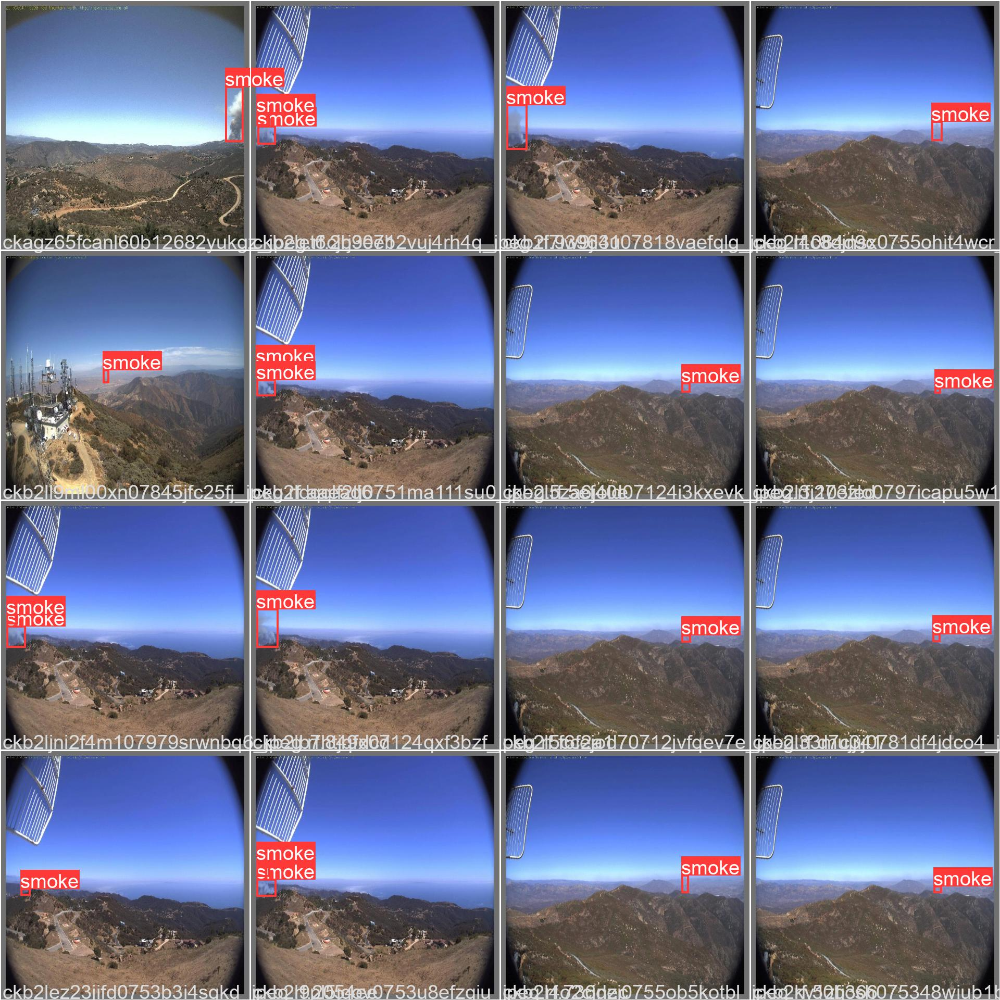

In [32]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename=f'/content/yolov5/runs/train/{most_recent_run}/val_batch0_labels.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


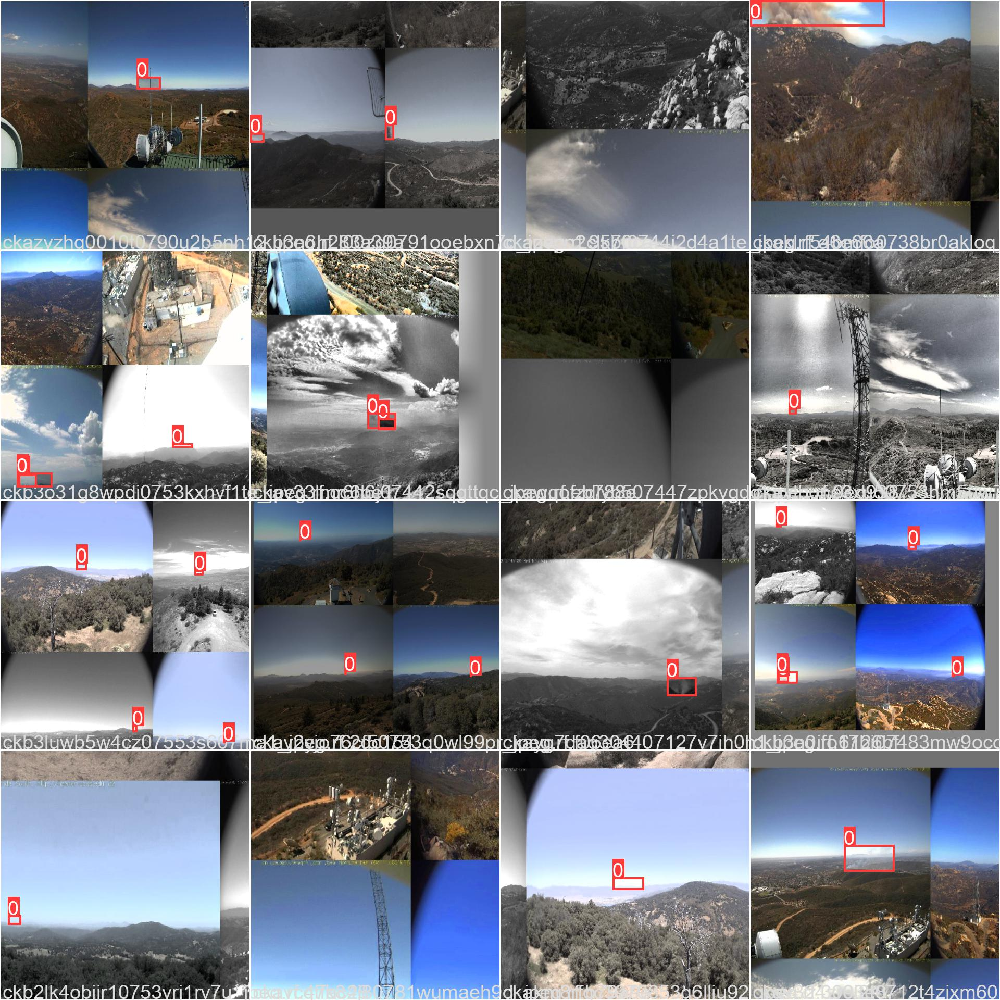

In [33]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename=f'/content/yolov5/runs/train/{most_recent_run}/train_batch0.jpg', width=900)

In [34]:
!python detect.py --weights runs/train/{most_recent_run}/weights/best.pt --img 640 --conf 0.4 --source /content/yolov5/wildfireData/test/images

detect: weights=['runs/train/yolov5m_results/weights/best.pt'], source=/content/yolov5/wildfireData/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-306-gfbe67e4 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5m summary: 290 layers, 20852934 parameters, 0 gradients, 47.9 GFLOPs
image 1/218 /content/yolov5/wildfireData/test/images/ckahefn6xf2sz0918qilabaa1_jpeg.rf.9a8e516b6ed9e76ece1ba2be1e249390.jpg: 640x640 1 smoke, Done. (0.029s)
image 2/218 /content/yolov5/wildfireData/test/images/ckak74d5c6os70738dllqyvp6_jpeg.rf.e0ffb04a65f2d093a7f93a42e1fad268.jpg: 640x640 1 smoke, Done. (0.029s)
imag

In [35]:
most_recent_preds = os.listdir("runs/detect")
most_recent_preds.sort()
most_recent_preds = most_recent_preds[-1]

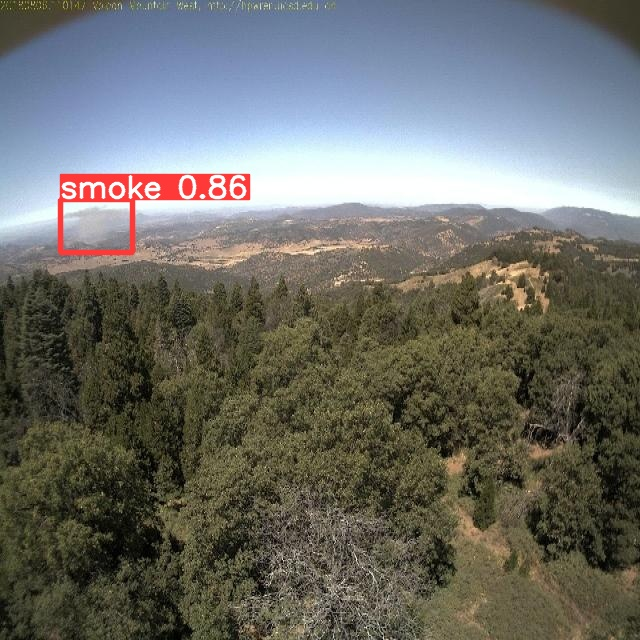

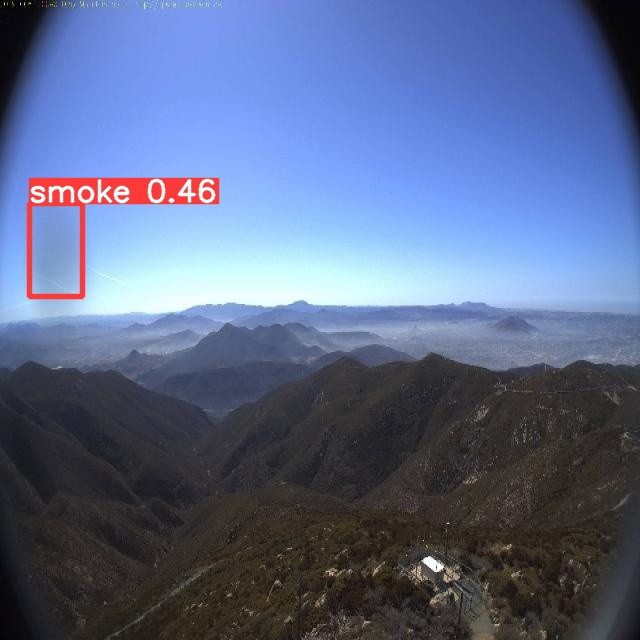

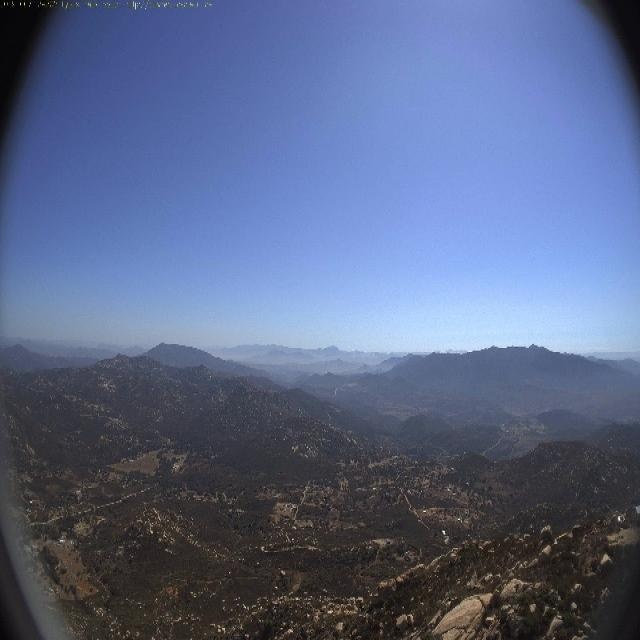

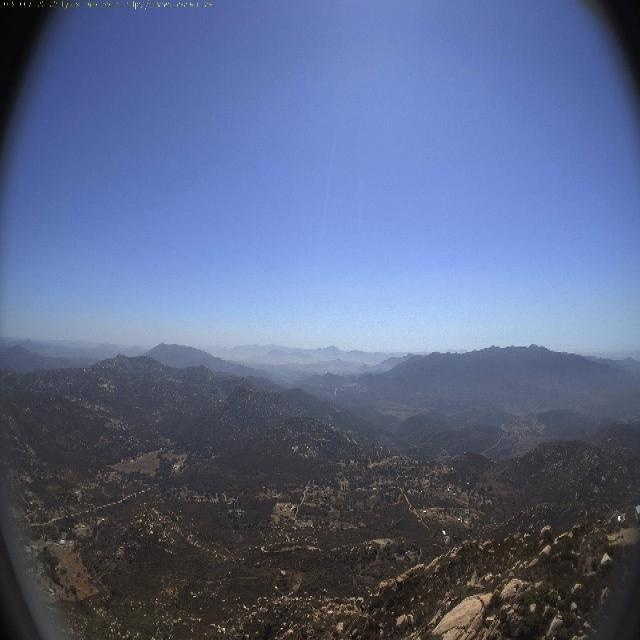

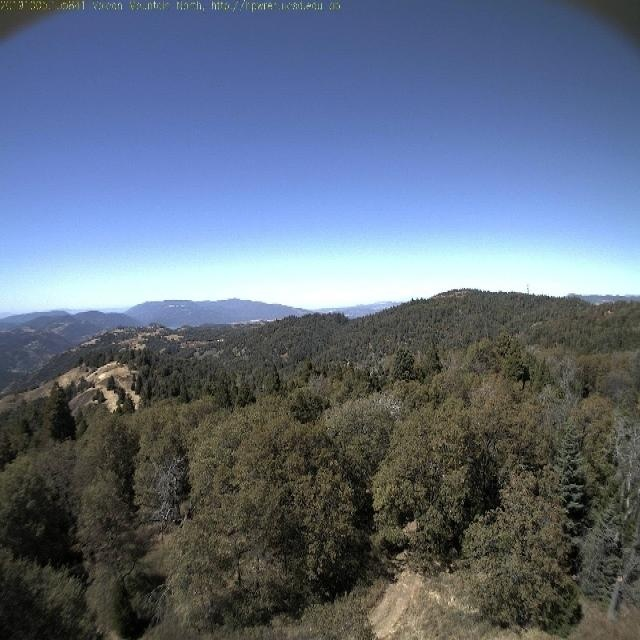

...

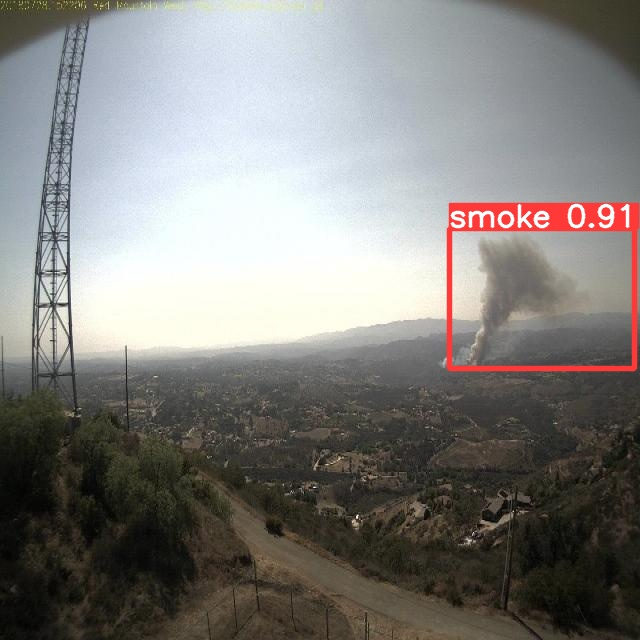

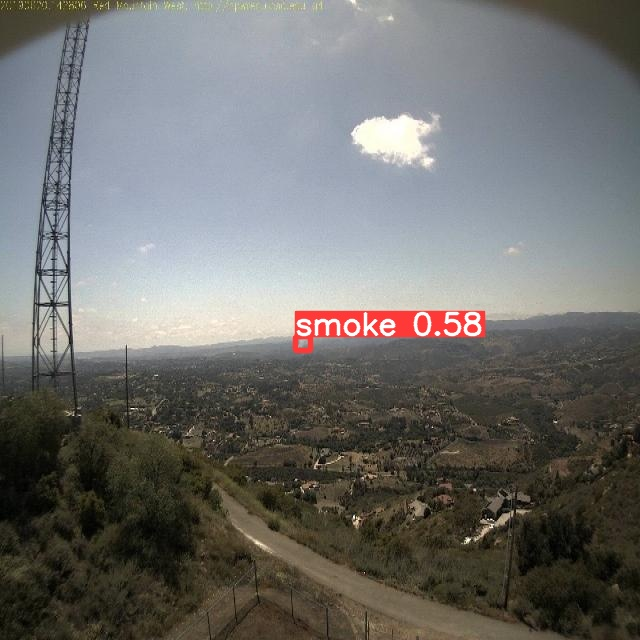

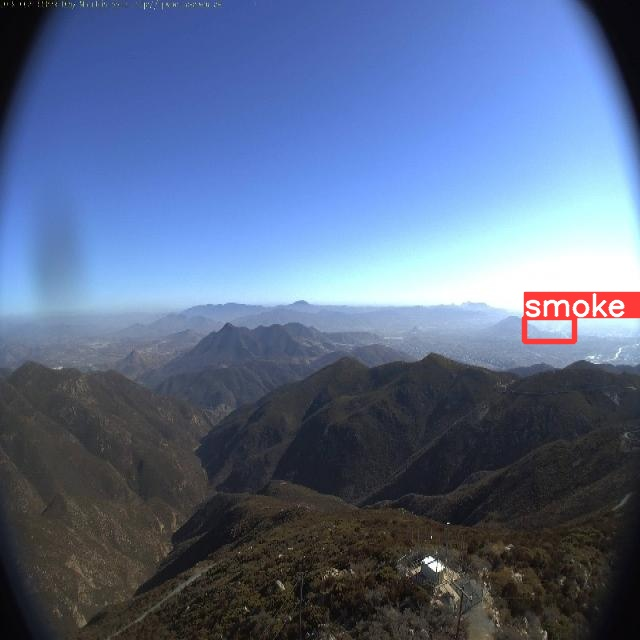

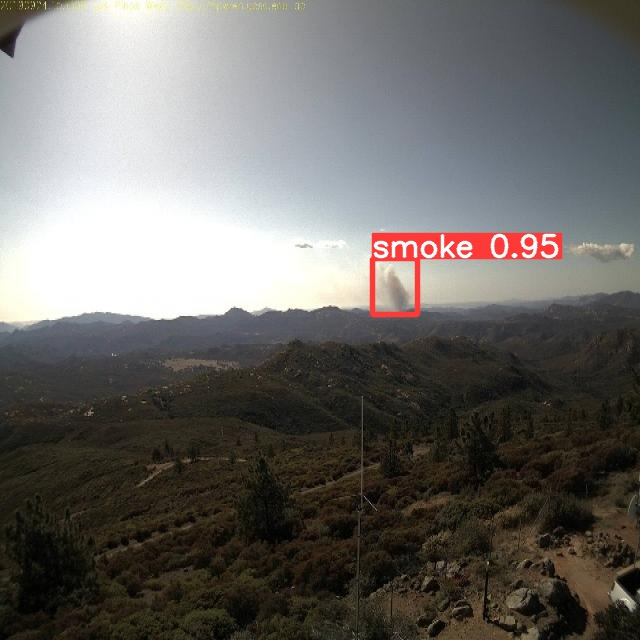

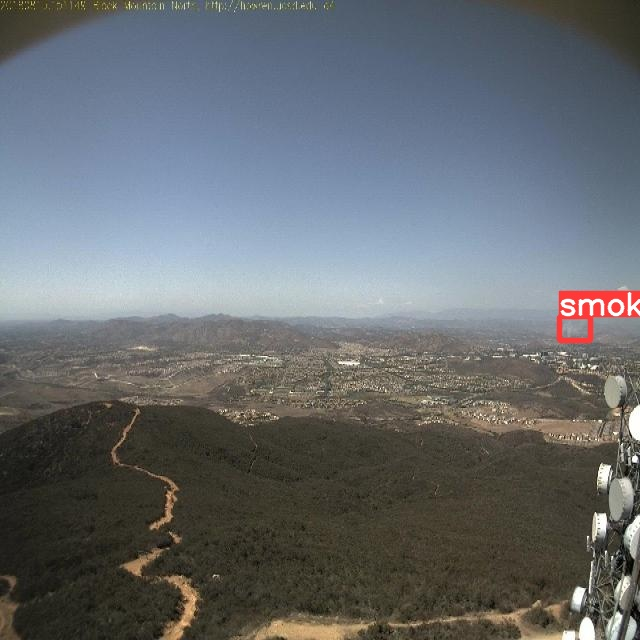

In [36]:
import glob
from IPython.display import Image, display

for imageName in glob.glob(f'/content/yolov5/runs/detect/{most_recent_preds}/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Zipping the yolov5 folder

In [37]:
%cd ..

/content


In [39]:
!zip -qr yolov5.zip /content/yolov5